# Overview and Introduction

This notebook provides an overview of the Advanced ACTPol (AdvACT) data release 4 (DR4) data products and an introduction to accessing and manipulating these products.  The data products (summarized in Table 1)  include temperature and polarization maps, a lensing map, and component seperated maps. 

DR4 contains raw maps at 90, and 150 GHz covering nearly half the sky as well as co-adds of the 90, 150 and 220 GHz channels.  Previous analyses used only ~650 sq deg of sky; this data release provides maps that cover ~ 18,000 sq degrees.  We provide these maps both independently and combined with data from the Planck satellite.  For more details on the coadded data products and to understand the methods used to produce the maps please reference [Naess et al. (2020)](https://www.overleaf.com/5395816498bsknshgxbmyr). 

---
Table 1: Overview of Data Products
---

Product type | Maps | Area Covered| Other products
---|---|---|---
Season 08 - 18 Coadded Maps| T, Q, U @ 90,150 and 220 GHz  | ~18,000 sq degrees | beams, inverse variance (hit count maps), ACT only as well as ACT+Planck maps
Season 13 - 16 raw maps| T, Q, U @ 90 and 150 GHz | ~ 17,000 sq degrees | Individual splits, beams, inverse variance, source free maps
Lensing Maps| | ~2100 sq degrees |  Masks, simulations
Component Separated maps| Compton-y maps and CMB + kSZ | ~2100 sq degrees | Masks, Beams and Noise, ACT only as well as ACT+Planck maps




---
  

DR4 includes the lensing maps discussed in [Darwish et al. (2020)](https://arxiv.org/pdf/2004.01139.pdf/).  The maps are constructed using two frequency bands, 98 GHz and 150 GHz and data from seasons 2014 - 2015 in two regions of the sky, BOSS-North ( \~1633 sq. degrees of sky) and D56 (\~ 456 sq. degrees). 

We also include component separated maps in the D56 and BOSS-North regions.  These maps include CMB+kSZ maps and Compton-$y$ maps along with versions of these maps the specifically deproject individual components.  These maps can be used to study the pressure profiles of galaxies, groups and clusters as well as for lensing reconstruction and kinematic SZ cross-correlations [Madhavacheril et al. (2020)](https://www.overleaf.com/read/hnjnxpzgrrtp).

Finally we include raw maps that include night time data from Season 13 through 16 at 98 and 150 GHz.  The maps cover more than 17,000 sq degrees, with the deepest 600 sq degrees having noise levels below 10µK–arcmin.  These maps won't be used in this notebook but are discussed in more depth in [Aiola et al. (2020)](https://phy-wiki.princeton.edu/polwiki/pmwiki.php?n=Papers.Papers?action=download&upname=ACT_DR4_A20_v20200420.pdf)and are used in the companion notebook.  

These data are stored in the CAR (or Plate Carée) format as ndmap objects.  These are based off of numpy arrays and include a 2D array and a WCS object that includes information needed to relate the 2D array to the celestial sphere.  This is distinct from the [HEALPix](https://healpix.sourceforge.io/) format commonly used in cosmology.  Therefore we provide an introduction to the tools needed for manipulating these maps and for converting between HEALPix and CAR format.   The library that accomplishes this is called [PIXELL](https://github.com/simonsobs/pixell).  
 
 The resources themselves can be found on the [NASA Legacy Archive Microwave
Background Data Analysis website](https://lambda.gsfc.nasa.gov/product/act/).  Users are welcome to use the data products and the examples shared in these notebooks in order to study the new data set.

## Data products discussed in this Notebook
This notebook will introduce users to the Pixell framework and demonstrate how to read in CAR maps and look at objects in the maps.  The notebook can also be used to stack point sources given a catalog of objects and convert maps between the CAR and HEALPix framework.

DR4 includes a multitude of data products as discussed above.  This notebook will focus on introducing the range of products and demonstrating how to access and examine the various maps.

To run the entirety of this notebook you will need to have the following data products downloaded:
> ACT + Planck Coadded map : "act_planck_s08_s18_cmb_f150_night_map_I.fits"

> Planck Map : "HFI_SkyMap_143_2048_R2.02_halfmission-1.fits"

> Cluster catalog : 'E-D56Clusters.fits'

> List of Messier objects : "messier_objs.csv"

> Lensing Map : "mc_corrected_realKappaCoadd_s14&15_deep56New.fits"

> Compton-$y$ : "tilec_single_tile_deep56_comptony_map_v1.2.0_joint.fits"

> CMB + kSZ : "tilec_single_tile_deep56_cmb_map_v1.2.0_joint.fits"

> CMB + kSZ with tSZ deprojected : "tilec_single_tile_deep56_cmb_deprojects_comptony_map_v1.2.0_joint.fits"

> Fiducial CMB spectrum from CAMB: "camb_theory.dat"


All of the AdvACT products can be found on [LAMBDA](https://lambda.gsfc.nasa.gov/product/act/).  We also use a Planck map that can be found in Planck's [second data release](https://irsa.ipac.caltech.edu/data/Planck/release_2/all-sky-maps/maps/HFI_SkyMap_143_2048_R2.02_full.fits).  Both the list of messier objects and the fiducial CMB spectrum from camb are in the data folder in this github repository.  

If using this notebook in the Docker container place all of the data products you'd like to use in a local folder on your machine and link it to the 'data' folder by following the instructions in Github.  


## Table of contents

 --- 
> Section 1: Importing Pixell, Healpy and other key packages

> Section 2:  Guide to reading in and manipulating the season 08 - 18 coadded maps.  The example is done for the the 90 and 150 GHz combined map but can be modified to use other frequency bands.

> Section 3:  Demonstration of methods to converted maps between HEALPix format and the CAR format.

> Section 4:  Guide to using Pixell to look at objects in the maps and stacking our maps on catalogue positions.

> Section 5:  Introduction to the Lensing maps.

> Section 6:  Guide to the use of the Component Separated maps.

> Section 7:  Harmonic Analysis with CAR Maps

> Section 8:  Looks at how to generate E and B maps from I, Q, U maps.  <font color=red>(perhaps skip this or move it later)</font>

---


# Section 1: Importing packages

For more information on Pixell and Healpy feel free to read the relevant documentation.  They can be found here: [Pixell](https://github.com/simonsobs/pixell) and [Healpy](https://healpy.readthedocs.io/en/latest/).

In [30]:
import numpy as np
import matplotlib.pyplot as plt
import healpy as hp
import time
import sys
from pixell import enmap, enplot, reproject,utils
from matplotlib import cm
path = "data/"

# Section 2: S08-18 Coadded maps and an Introduction to Pixell

This section will walk users through how to use Pixell and access maps.  The demonstration is done using the 150 GHz ACT + Planck S08-18 coadded maps discussed in [Naess et al. (2020)](https://www.overleaf.com/5395816498bsknshgxbmyr).  The other coadded maps provided are listed in Table 2.  Substituting these file names allows you to switch between frequencies, maps built with and without planck, and the coadded map used in this example.

For each frequency, we provide both temperature and polarization data.  The polarization angle has been calibrated, but the polarization leakage of the beam has not been corrected and we do not provide a complete noise model.  We will release fully vetted polarization maps including splits with which the noise can be evaluated in a future release.  In the present form cosmological analysis of these spectra is not possible though one can use these coadded maps for studies of foregrounds, the galaxy, and (with proper care) point source properties.

These maps are produced by combining observations from multiple seasons and arrays as well as from both ACT and Planck. The results are combined multi season maps that are easier to use and understand than the individual season or array maps used to create them.   This method is explained in much greater detail in [Naess et al. (2020)](https://www.overleaf.com/5395816498bsknshgxbmyr)

Here we present the coadded maps which cover an area of $0^o < RA < 360^o$, $-62^o < dec < 22^o$ and include variations with and without Planck data.  The maps correspond to an area of 26.4 thousand square degrees, of which about 70% is exposed.

 ---
Table 2: Coadded S08-s18 Maps
---


 Map File Name | Key Details
 ---|---
 act_s08_s18_cmb_f090_night_map_srcfree_I.fits | 90 GHz ACT only, source free maps,  units of $\mu$K  (Replace I with Q or U to get other components)
  act_s08_s18_cmb_f090_night_map_I.fits | 90 GHz ACT only, point sources included, units of $\mu$K (Replace I with Q or U to get other components)
  act_s08_s18_cmb_f090_night_ivar.fits | 90 GHz ACT only, inverse variance (similar to hit count maps) units of $1/ \mu K^2$
  |
   act_s08_s18_cmb_f150_night_map_srcfree_I.fits | 150 GHz ACT only, source free maps,  units of $\mu$K  ((Replace I with Q or U to get other components)
  act_s08_s18_cmb_f150_night_map_Q.fits | 150 GHz ACT only, point sources included, units of $\mu$K (Replace I with Q or U to get other components)
  act_s08_s18_cmb_f150_night_ivar.fits | 150 GHz ACT only, inverse variance (similar to hit count maps) units of $1/ \mu K^2$ 
   |
   act_s08_s18_cmb_f220_night_map_srcfree_I.fits | 220 GHz ACT only, source free maps,  units of $\mu$K  (Replace I with Q or U to get other components)
  act_s08_s18_cmb_f220_night_map_I.fits | 220 GHz ACT only, point sources included, units of $\mu$K (Replace I with Q or U to get other components)
  act_s08_s18_cmb_f220_night_ivar.fits | 220 GHz ACT only, inverse variance (similar to hit count maps) units of $1/ \mu K^2$ 
  | 
  **ACT + Planck Maps**|
   act_planck_s08_s18_cmb_f090_night_map_srcfree_I.fits | 90 GHz  ACT + Planck combined, source free maps,  units of $\mu$K  (Replace I with Q or U to get other components)
  act_planck_s08_s18_cmb_f090_night_map_I.fits | 90 GHz ACT + Planck combined, point sources included, units of $\mu$K (Replace I with Q or U to get other components)
  act_planck_s08_s18_cmb_f090_night_ivar.fits | 90 GHz  ACT + Planck combined, inverse variance (similar to hit count maps) units of $1/ \mu K^2$ 
  |
   act_planck_s08_s18_cmb_f150_night_map_srcfree_I.fits | 150 GHz  ACT + Planck combined, source free maps,  units of $\mu$K  (Replace I with Q or U to get other components)
  act_planck_s08_s18_cmb_f150_night_map_I.fits | 150 GHz  ACT + Planck combined, point sources included, units of $\mu$K (Replace I with Q or U to get other components)
  act_planck_s08_s18_cmb_f150_night_ivar.fits | 150 GHz  ACT + Planck combined, inverse variance (similar to hit count maps) units of $1/ \mu K^2$ 
  |
   act_planck_s08_s18_cmb_f220_night_map_srcfree_I.fits | 220 GHz  ACT + Planck combined, source free maps,  units of $\mu$K  (Replace I with Q or U to get other components)
  act_planck_s08_s18_cmb_f220_night_map_I.fits | 220 GHz  ACT + Planck combined, point sources included, units of $\mu$K (Replace I with Q or U to get other components)
  act_planck_s08_s18_cmb_f220_night_ivar.fits | 220 GHz  ACT + Planck combined, inverse variance (similar to hit count maps) units of $1/ \mu K^2$ 

---


## Reading in the maps

Here we will demonstrate how to initially read in CAR maps and how to examine them using various Pixell based tools.

In this example we will read in the 150 GHz intensity map, denoted by the final I in the name.   You can read the various maps described in Table 2 using the same command.


In [7]:
imap = enmap.read_map(path + "act_planck_s08_s18_cmb_f150_night_map_I.fits")

These CAR maps are stored as ndmap objects which are based off of the numpy array framework.  Previously ACT maps were made with the cylindrical equal-area (CEA) projection.  This worked well for smaller areas but due to the new larger area of the AdvACT survey we have adopted the Plate Carée pixilation.  The CAR projection, as described above, is a rectangular projection, however, it is not a flat sky projection.  Instead in each latitude ring, pixels are spaced such that there are equal number of pixels in each latitude ring.  This means that the physical space between pixels depends on the ring and pixels near the equator have a larger physical space difference between them than ones near the poles.  What this means is we are able to run spherical harmonic, and thus cruvedsky, analyses on the maps despite presenting them as 2D Numpy objects [Choi et al.](https://phy-wiki.princeton.edu/polwiki/pmwiki.php?n=Papers.Papers?action=download&upname=choi_etal_2020.pdf).


The maps are stored as arrays with a WCS object that describes the relation between pixel space and the celestial sphere. In order to examine the WCS and shape of the maps simply call the objects as shown here.



In [8]:
print(imap.shape)
print(imap.wcs)

(10320, 43200)
car:{cdelt:[-0.008333,0.008333],crval:[0,0],crpix:[2.16e+04,7561]}


The WCS object includes important information that Pixell uses to handle the maps.  The first item is the projection which for this map is 'car'.  While Pixell can handle other projections, the most recent ACT maps are all in CAR, or Plate Carée, format.  This means that the sky can be directly mapped on to the pixels using the simple relations:
$$\phi  = x, \quad \theta = y$$ 

Where $\phi$ is the Right Ascension and $\theta$ is declination.

For more information on WCS objects consider referencing the [astropy wcs documentation](http://docs.astropy.org/en/stable/wcs/index.html) . 

## Visualizing the maps

In order to visualize the maps enplot has built in tools that allow you to easily plot them, the full list of these can be found in the code available on github.

Here we provide several examples of these features including downgrading, which is done internally through pixel averaging , adjusting the frequency of the ticks on the axes and displaying a color bar. 

Some other useful ones that are used later in this notebook are:

*   "upgrade" - useful for plotting small stamps around point sources
*   "min" and "max" - set the color range for the colorbar
*   "color" - set the color map for the maps (e.g. planck, wmap, hotcold, etc.)





In [9]:
def eshow(x,**kwargs): 
    ''' Define a function to help us plot the maps neatly '''
    plots = enplot.get_plots(x, **kwargs)
    enplot.show(plots, method = "ipython")

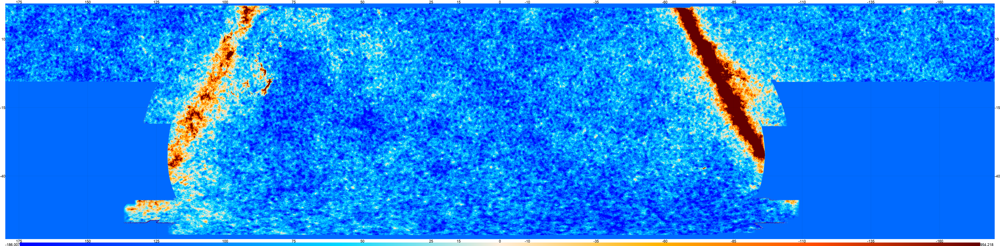

In [10]:
keys = {"downgrade": 8, "ticks": 25, "colorbar": True} # add "color", "min", "max", etc keys here to adjust your plot 
eshow(imap, **keys)

### Selecting a smaller patch of the sky

One of the advantages of using the CAR and Pixell framework is that you can easily select a small region of the map to examine in more detail.  Users can select a submap at a specific location by creating a bounding box around a central location in RA and DEC.  For example if we wanted to visualize an object at RA = 0 and dec = 0  we can create a box, with a width of 5 degrees, around this location.  Note that Pixell takes in bounding boxes in radians so here we convert the dec, ra and width to radians using numpy before forming the box.

You can also create a box using the framework:

> box = [[dec_from, ra_from],[dec_to, ra_to]] $\quad$ (in radians)

 

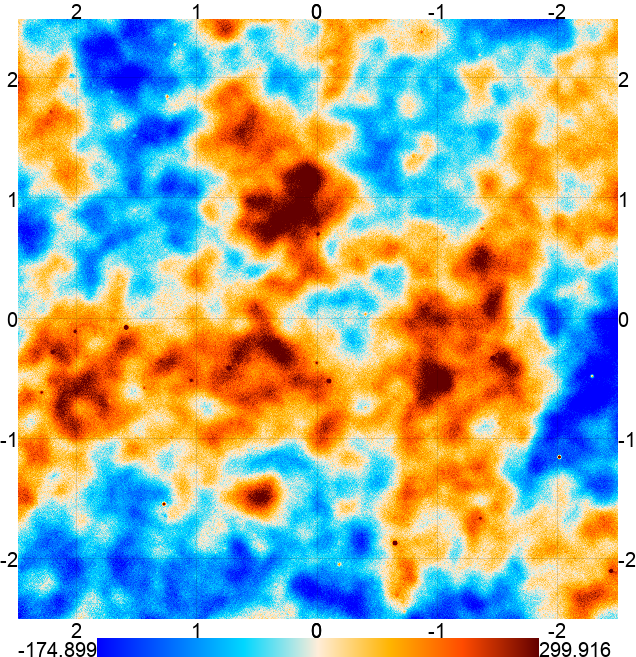

car:{cdelt:[-0.008333,0.008333],crval:[0,0],crpix:[2.16e+04,7561]}

In [11]:
# Set up a box around dec = 0 and ra = 0
dec,ra = np.deg2rad([0,-0])

# Give the box a width of 5 degrees
width = np.deg2rad(5)

# Create the box and use it to select a submap
box = [[dec-width/2.,ra-width/2.],[dec+width/2.,ra+width/2.]]
smap = imap.submap(box)

# Plot the map using the eshow function we defined earlier
eshow(smap, **{"colorbar":True})
imap.wcs

### Selecting a patch using pixel indexing
Alternatively we can slice the map using numpy array indexing to get a submap.  This will select a submap using the indexes of the pixels themselves instead of sky coordinates.  We will do that now for a larger area.  

What's useful about this is that you can treat the maps like a numpy array and pixell will automatically handle fixing the map projections as needed by adjusting the wcs information stored with the map.  If you look at the two wcs's printed after the map you can see the resolution stayed fixed but the center pixel adjusted when we cut the map.

Later on in this notebook we will use this method to look at galaxy clusters and Messier objects.

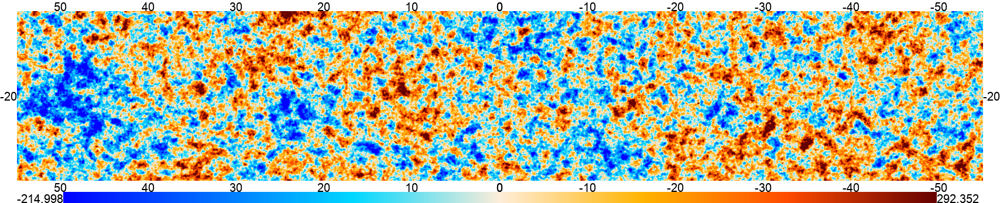

car:{cdelt:[-0.008333,0.008333],crval:[0,0],crpix:[2.16e+04,7561]}
car:{cdelt:[-0.008333,0.008333],crval:[0,0],crpix:[6601,3561]}


In [12]:
smap_2 = imap[4000:-4000,15000:-15000]

eshow(smap_2, **{"downgrade": 8, "colorbar":True, "ticks": 10})

print(imap.wcs)
print(smap_2.wcs)

# Section 3: Converting Between CAR and HEALPix Maps


Pixell is designed to allow users to convert maps between HEALPix format and ndmap format.  This is particularly useful for users interested in comparing maps readily available as HEALPix maps to ACT maps.  The following code demonstrates a simple reprojection from one format to another.

When reprojecting it's helpful to keep in mind that Pixell automatically rotates maps from Planck's Galactic projection to Equatorial, if you are projecting a different map other rotations may be needed. 

Note that projections work by finding the spherical harmonic transformation of the HEALPix map to alm's and then inversely transforms the alm's to the rectangular pixel map geometry.  

Finally for anyone in looking at small patches of the sky we encourage you to use the maps in CAR format with Pixell as it enables users to reference patches in a way that HEALPix can't do.

NSIDE = 2048
ORDERING = NESTED in fits file
INDXSCHM = IMPLICIT


//anaconda3/lib/python3.7/site-packages/healpy/fitsfunc.py:372: UserWarning: No INDXSCHM keyword in header file : assume IMPLICIT
  warnings.warn("No INDXSCHM keyword in header file : " "assume {}".format(schm))


Ordering converted to RING
Preparing SHT
T -> alm
float64 complex128
Computing pixel positions
Computing rotated positions
Projecting


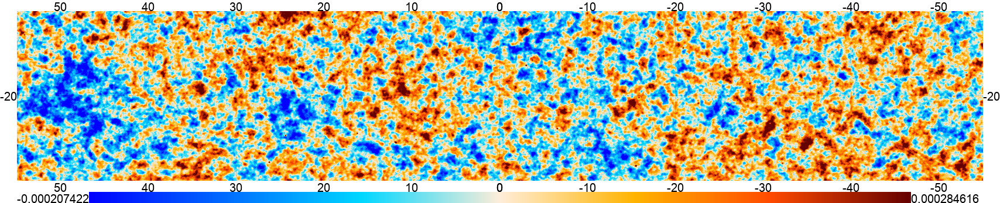

In [13]:
# Convert a planck HEALPix map to ndmap
pmap_fname = path + "HFI_SkyMap_143_2048_R2.02_halfmission-1.fits"
planck_map = reproject.enmap_from_healpix(pmap_fname, smap_2.shape, smap_2.wcs, \
                                  ncomp=1, unit=1, lmax=6000,rot='gal,equ')
eshow(planck_map, **{"downgrade": 8, "colorbar":True, "ticks": 10, })

We can also take our trimmed ACT map and project it to the HEALPix format using reproject as shown here.

Sigma is 0.000000 arcmin (0.000000 rad) 
-> fwhm is 0.000000 arcmin


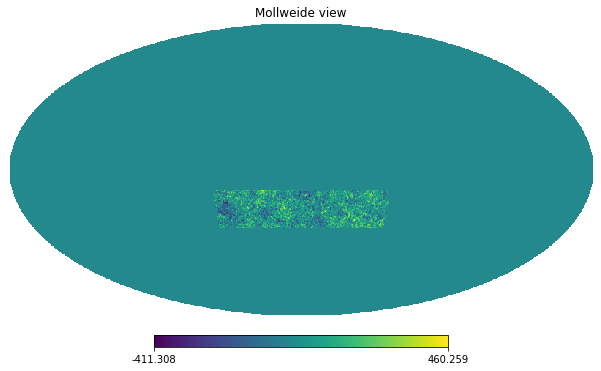

In [14]:
# Convert an ndmap map to HEALPix
smap_healpix = reproject.healpix_from_enmap(smap_2, lmax = 6000, nside = 512)
hp.mollview(smap_healpix)

# Section 4: Use a catalog to visualize objects in the map

In the above map it's already possible to see a few galaxy clusters just by visually examining the map.  However it would be great to be able to look at these more closely.  One option is to use a catalog of clusters and compare the catalog to the map.  In order to do so we need to get the RA and DEC of the relevant sources and then cut a box surrounding that location.

In [4]:
from astropy.io import fits

hdu = fits.open(path + 'E-D56Clusters.fits')
ras = hdu[1].data['RADeg']
decs = hdu[1].data['DECDeg']

One way to look at a source is to build another box and take a stamp.  Let's make the box slightly smaller this time in order to hone in on the objects we are interested in.  

This time we will use enplot's upgrade feature in order to plot a larger image of the object.

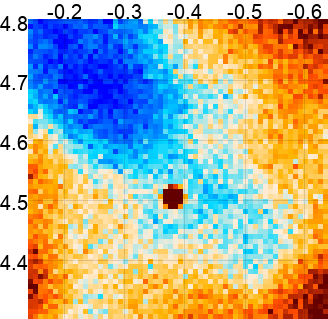

In [16]:
# Choose an object from the catalog 
dec,ra = np.deg2rad([ras[12],decs[12]])
width = np.deg2rad(30./60.)

# Build the box around the object and cut out a submap from the larger map
box = [[dec-width/2.,ra-width/2.],[dec+width/2.,ra+width/2.]]
stamp = imap.submap(box)

# Visualize the submap
eshow(stamp, **{"upgrade": 5, "ticks": 0.1})

## Stacking point sources and using reproject

If we want to stack objects in the map it's relatively easy to do so but we need to use a slightly different approach.  Instead of using a bounding box and cutting a submap from the map we can use pixell's reproject.postage_stamp function to cut out postage stamps that are reprojected at the center of each object. 

Reprojecting means that we avoid stacking point sources that are distorted due to the rectangular projection as it will automatically center the projection on each individual point source.

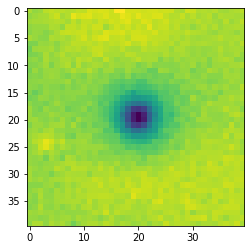

In [17]:
N = len(ras)
stack = 0

for i in range(N):
    # Extract stamps by reprojecting the map at the center of each source.
    # the 'postage_stamp' option here is designed to trim each reprojection so we
    # are left with a stack of point sources in a map of width 20 arc minutes
    stamp = reproject.postage_stamp(inmap = imap , ra_deg = ras[i], dec_deg = decs[i], width_arcmin = 20.,
                  res_arcmin = .5)
    if stamp is None: continue 
    stack += stamp[0]
    
stack /= N
plt.imshow(stack)
plt.show()

## Plot Messier objects

While users are free to search for objects in the maps using catalogs we've also provided a tool to plot random Messier objects from our maps below.  You can enter the Messier number of an object you'd like to look at or feel free to let the function generate a random object for you to look at.

In [3]:
from astropy.io import ascii
import astropy.coordinates as coord
import astropy.units as u
import random 

In [19]:
def plot_messier(M = None):
  # M should be an integer 

  # read in a table of messier objects that overlap with our feild of view
  tbl = ascii.read(path +"messier_objs.csv", encoding = "utf-8")
  tbl.rename_column("\ufeffM", "M")

  # Check if user has given an object to look for
  if M != None:
    M = str('M') + str(M)
    A = list(tbl['M'])
    if M in A:
      obj = tbl[A.index(M)]
    else:
      print("Sorry that object isn't visible in this map")

  # If no object is given select a random one
  if M == None:
    obj = tbl[random.randint(0, len(tbl))] 

  # Get the RA and DEC of the object
  ra = coord.Angle(obj["RA"], unit=u.hour) 
  dec = coord.Angle(obj["Declination"], unit = u.degree) 

  # Get a plot of the object
  stamp = reproject.postage_stamp(inmap = imap , ra_deg = ra.degree, \
              dec_deg = dec.degree, width_arcmin = 20., res_arcmin = .5)
  

  # Establish name for the object, if the common name is given use that, if not 
  # we just use the NGC and M indentifiers
  if type(obj["Common Name"] ) == np.str_:
      name = str(obj["Common Name"])  + str(' NGC: ') + str(obj["NGC"]) + \
      str(' ') + str(obj["M"])
  else:
      name = str('NGC: ') + str(obj["NGC"])+ str(' ') + str(obj["M"])
  
  # Plot the object 
  plt.imshow((stamp[0]))
  plt.title(name)
  plt.show()
  
  return 


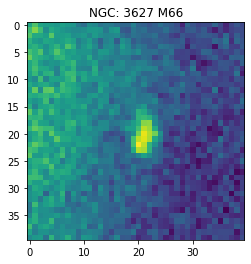

In [20]:
# Try this a few times - some of the objects may be clearer than others
plot_messier()

# Section 5: Lensing Maps

As part of the ACT data release 4 (DR4) lensing maps constructed using data from Seasons 2014-2015 are publicly available.  These maps are discussed more in depth in [Darwish et al](https://arxiv.org/pdf/2004.01139.pdf). but this section will help users access and examine the maps. 


The two seasons of 98 GHz and 150 GHz maps are coadded to produce the input maps for the lensing estimator.  These input maps are discussed in more detail in the paper but are constructed such that point sources are masked and the beam is deconvolved.

The lensing maps can be accessed and used with the same Pixell commands implemented for previous maps meaning users can trim them and study small patches as needed. The available files are documented in table 3.

For a tutorial demonstrating how the lensing maps are reconstructed consult this [notebook](https://github.com/simonsobs/pixell_tutorials/blob/master/PixellSoapackSymlens.ipynb).


---
Table 3: Lensing Maps
---

Map File Name | Description
---|---
mc_corrected_realKappaCoadd_s14&15_deep56New.fits | Deep 56 lensing map
mc_corrected_realKappaCoadd_s14&15_bossNew.fits | Boss North lensing map
mc_corrected_realKappaCoadd_sim#_s14&15_deep56New.fits | Simulations where sim# = 001 -  511 for the deep 56 region
mc_corrected_realKappaCoadd_sim#_s14&15_bossNew.fits | Simulations where sim# = 001 -  511 for the Boss North region

---
Masks:
Masks for both regions are provided as fits files

In [21]:
lensed = enmap.read_map(path + "mc_corrected_realKappaCoadd_s14&15_deep56New.fits")

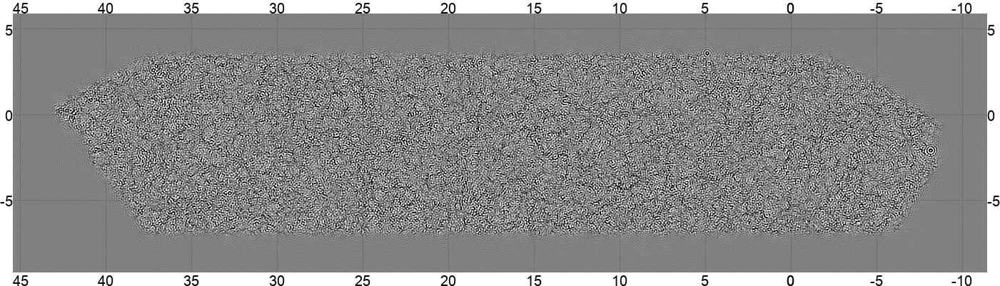

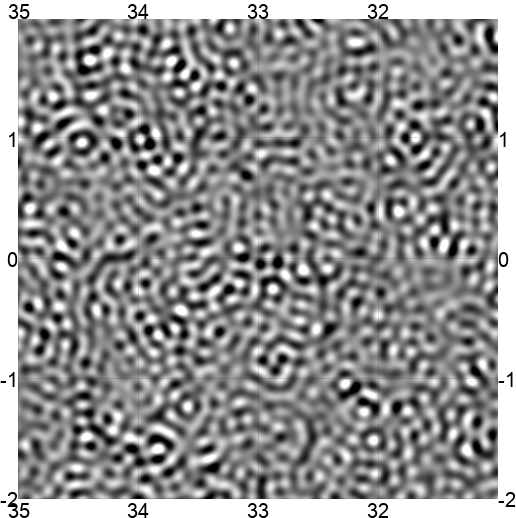

In [22]:
# Plot the entire map and thenn a smaller slice of it using the "sub" key 
eshow(lensed, **{"downgrade": 5, "ticks": 5, "color": 'gray'})
eshow(lensed,**{"sub":"-2 :2 ,35:31", "color": 'gray'} )

# Section 6: Component Separated Maps 

As part of DR4 we present component separated maps.  These maps cover about 2100 square degrees and have arcminute-resolution.  To produce these component separated maps we implemented an internal linear combination (ILC) algorithm.  

The ILC approach uses a linear co-addition of input maps in multiple frequencies to minimize variance of the final map while preserving the signal of interest.  It does so solely by relying on information about the frequency dependence of the various components.  Traditionally the ILC method doesn't explicitly remove any foregrounds, however, our approach works to explicitly null some of the foreground contamination.  However, it is important to note that since it is not possible to fully remove foreground contamination the auto-power spectrums of the resulting maps should be interpreted with significant caution.

Here we demonstrate how to read in and examine the Compton-$y$ and CMB+kSZ maps produced by this process.  In particular we note that it's possible to see galaxy clusters in the Compton-$y$ map by eye.  

Reference: [Madhavacheril et al. (2020)](https://www.overleaf.com/read/hnjnxpzgrrtp)

---
Table 4: Component Separated Maps
---
Map Type| File Name
---|---
CMB+kSZ maps| 
Map | tilec_single_tile_deep56_cmb{,_deprojects_comptony,_deprojects_cib}_map_v1.2.0_joint.fits 
Beam | tilec_single_tile_deep56_cmb{,_deprojects_comptony,_deprojects_cib}_map_v1.2.0_joint_beam.txt 
Noise | tilec_single_tile_deep56_cmb{,_deprojects_comptony,_deprojects_cib}_map_v1.2.0_joint_noise.fits
Cross-Noise |	tilec_single_tile_deep56_cmb{_deprojects_comptony,_deprojects_cib}_comptony_map_v1.2.0_joint_cross_noise.fits 
Weights | tilec_single_tile_deep56_cmb{,_deprojects_comptony,_deprojects_cib}_map_v1.2.0_joint_ARRAY_weight.fits 
| 
tSZ/Compton-Y maps| |
Map | tilec_single_tile_deep56_comptony{,_deprojects_cmb,_deprojects_cib}_map_v1.2.0_joint.fits 
Beam | tilec_single_tile_deep56_comptony{,_deprojects_cmb,_deprojects_cib}_map_v1.2.0_joint_beam.txt 
Noise | tilec_single_tile_deep56_comptony{,_deprojects_cmb,_deprojects_cib}_map_v1.2.0_joint_noise.fits 
Cross-Noise | tilec_single_tile_deep56_comptony{_deprojects_comptony,_deprojects_cib}_comptony_map_v1.2.0_joint_cross_noise.fits 
Weights | tilec_single_tile_deep56_comptony{,_deprojects_cmb,_deprojects_cib}_map_v1.2.0_joint_ARRAY_weight.fits 
_
Mask |tilec_mask.fits
 



These maps are named according to the Deep56 region.  To access the Boss region instead simply substitute 'boss' for 'deep56' in the names above.

Notice that the map, beam, noise and weights come in options that do not deproject anything, or that deproject another component. The former probably should be your baseline, and the latter should be used for systematics tests since they are noisier.

In the above, the most important products for your analysis are 'Map' and 'Beam'. 'Map' is a FITS file with a 2D array and a WCS header. 'Beam' is an ASCII file with two columns, the first corresponding to multipole number and the second corresponding to the effective beam transfer function in the map. 

'Noise' contains the 2D Fourier space total noise power spectrum from the ILC pipeline (this includes both signal and instrument noise). 'Cross-noise' is the total cross-power-spectrum of the standard map (no deprojection) with a particular choice of deprojection, as estimated by the ILC pipeline.

The 'Weights' FITS file contains the 2D Fourier space weight for each pixell corresponding to the array.

The 'mask' is an apodized mask with values ranging from 0 to 1. It has already been applied
to the map. All maps in a given directory use this same mask. If you are doing a real-space analysis,
you should exclude any pixels where the value in the mask is appreciably different from 1 since
the signal there should be attenuated by the value in the mask.

If you are doing a harmonic-space analysis, you should apply an overall correction to your
power spectrum of the form 1/mean(mask1 * mask2) (or equivalent for spherical harmonics).
(Note: Mode-coupling is probably unimportant for the Compton-Y map since the spectrum is not
very red. Mode-coupling can be important for the CMB map, but it's unlikely that you will
need to directly cross-correlate the CMB map in harmonic space. If you do, then
get in touch with us about how to handle the mode-coupling, since during reconstruction of
these maps, the mask was applied prior to a series of Fourier operations, and many 
power spectrum codes assume the mask has not yet been applied.)

In [23]:
# Here we demonstrate how to read in the deep 56 compton y map.  This is the same region 
# we looked at the lensing map for in the previous section

comptony = enmap.read_map(path + "tilec_single_tile_deep56_comptony_map_v1.2.0_joint.fits")

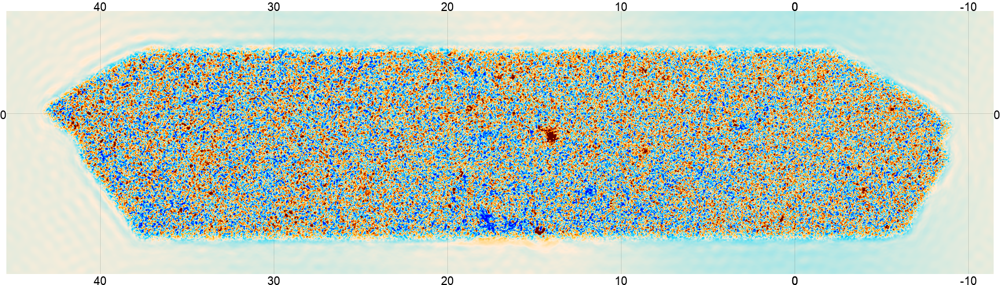

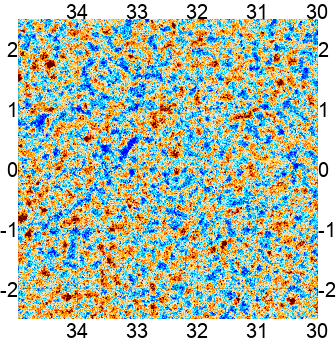

In [24]:
# We can plot the whole region - again adjust the 'downgrade' option to get a larger
# or smaller map
eshow(comptony, **{'downgrade': 4, 'ticks': 10})

# We can also look at a 'submap' using the 'sub' option in order to see more detail
eshow(comptony, **{"sub":"-2.5 :2.5 ,35:30", "downgrade": 2})

One of the interesting things to look at with component-separated maps is to look at the maps stacked at the locations of tSZ-clusters.  In particular we can compare the CMB+kSZ maps stacked at these locations to the CMB+kSZ maps with the tSZ effect deprojected. 

We can begin by reading in the relevant maps, in this case we want to consider the CMB+kSZ and the CMB+kSZ maps for the D56 region.  We will use the ACTPol + Planck maps in order to recreate stacks that are analogous to those shown in  figure 10 of [Madhavacheril et al. (2020)](https://www.overleaf.com/read/hnjnxpzgrrtp).


In [33]:
# Start by reading in the two relevant maps:
s
CMB_kSZ_D56 = enmap.read_map(path + "tilec_single_tile_deep56_cmb_map_v1.2.0_joint.fits")
CMB_kSZ_deproject_tsz_D56 = enmap.read_map(path + "tilec_single_tile_deep56_cmb_deprojects_comptony_map_v1.2.0_joint.fits")

Let's reuse our stacking code from earlier but apply the method to our two CMB+kSZ maps

In [34]:
hdu  = fits.open(path + 'E-D56Clusters.fits')
ras  = hdu[1].data['RADeg']
decs = hdu[1].data['DECDeg']
sn   = hdu[1].data["SNR"]

N = len(ras)
stack_CMB_kSZ           = 0
stack_CMB_kSZ_deproject = 0
c = 0

for i in range(N):
    # Extract stamps by reprojecting the map at the center of each source.
    # the 'postage_stamp' option here is designed to trim each reprojection so we
    # are left with a stack of point sources in a map of width 20 arc minutes
    
        
    stamp = reproject.postage_stamp(inmap = CMB_kSZ_D56 , ra_deg = ras[i], dec_deg = decs[i]\
                  , width_arcmin = 20., res_arcmin = .5)
    stamp_deproject = reproject.postage_stamp(inmap = CMB_kSZ_deproject_tsz_D56 \
                  , ra_deg = ras[i], dec_deg = decs[i], width_arcmin = 20., \
                  res_arcmin = .5)
    
    if stamp is None or stamp_deproject is None: continue 
    
        
    stack_CMB_kSZ += stamp[0]    
    stack_CMB_kSZ_deproject += stamp_deproject[0]
    c += 1
    
    
stack_CMB_kSZ /= c
stack_CMB_kSZ_deproject /= c

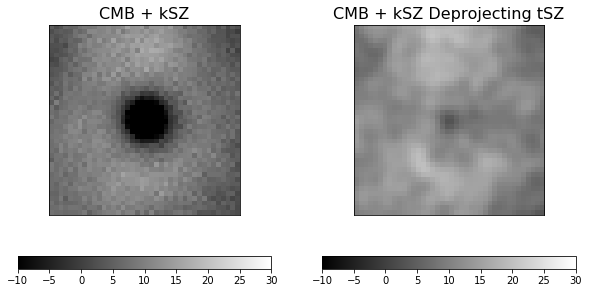

In [35]:
# Now we can plot both of these and compare

f, ax = plt.subplots(1,2, figsize=(10, 5))

f1 = ax[0].imshow(stack_CMB_kSZ, vmin = -10, vmax = 30, cmap = cm.gray)
ax[0].get_xaxis().set_visible(False)
ax[0].get_yaxis().set_visible(False)
ax[0].set_title("CMB + kSZ", fontsize = 16)
plt.colorbar(mappable = f1, ax = ax[0],orientation='horizontal')

f2 = ax[1].imshow(stack_CMB_kSZ_deproject, vmin = -10, vmax = 30, cmap = cm.gray)
ax[1].get_xaxis().set_visible(False)
ax[1].get_yaxis().set_visible(False)
ax[1].set_title("CMB + kSZ Deprojecting tSZ", fontsize = 16)
plt.colorbar(mappable = f2, ax = ax[1],orientation='horizontal')

plt.show()

As explained in [Madhavacheril et al. (2020)](https://www.overleaf.com/read/hnjnxpzgrrtp) the normal ILC procedure leaves behind large tSZ residuals as is evident in the left hand panel.  In comparison explicitly deprojecting the tSZ frequency massively reduces this residual.  

The slight difference we see between this and Madhavacheril et al. (2020) is due to the fact that we are using a publicly available catalog that contains much more massive clusters resulting in a slight, but visible, residual.

# Section 7: Harmonic Analysis using CAR maps

Now that users are able to import and examine these maps we now present an introduction to harmonic analysis using these maps.  We will present and example of a simple ACT Planck cross correlation here but we encourage users to consider cross correlations with other maps or galaxy density maps.

### Fourier transforms using Enmap

We will begin by trimming both ACT and Planck maps to the same size and then use enmap's functions to Fourier transform the map using the 'flat-sky' approximation.  

Before Fourier transforming the maps it is necessary to apodize the edges of the maps so that periodic boundary conditions apply.  This can easily be done using the enmap functions and the taper can be adjusted by changing the 'apod_pix' variable which adjusts the number of pixels that are apodized.

Here we chose to display only the I maps, however, the Q and U maps can of course be tapered in the same manner if desired.

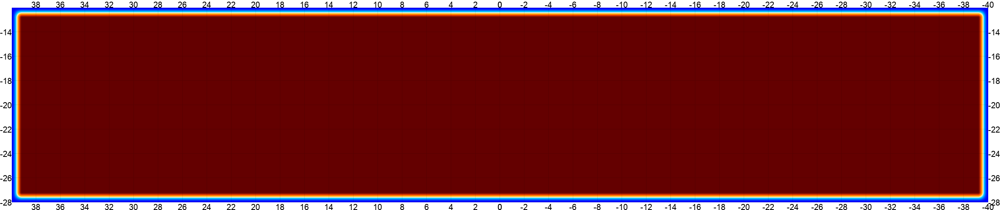

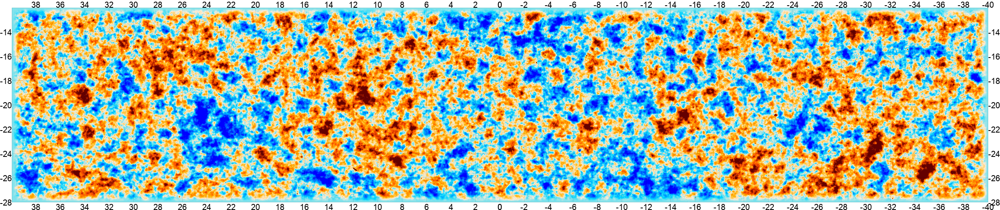

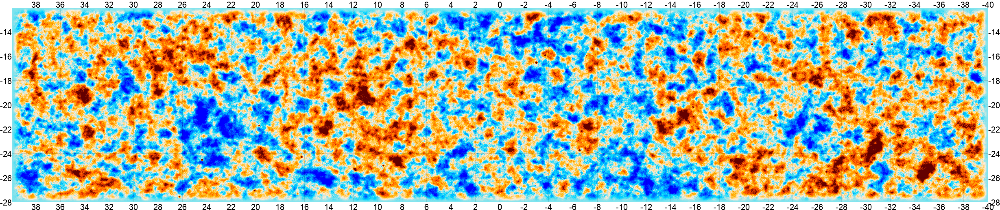

In [28]:
# Trim Maps
box = np.array([[-28,40],[-12,-40]])*utils.degree
smap_act    = smap_2.submap(box)
smap_planck = planck_map.submap(box)

# Define taper using enmap.apod and then plot the taper
apod_pix = 100 
taper    = enmap.apod(smap_act*0+1,apod_pix) 
eshow(taper,  **{"downgrade": 4, "ticks": 2})

# Apply taper to the two maps by multiplying the taper and maps together
eshow(taper*smap_act, **{"downgrade": 4,  "ticks": 2})
eshow(taper*smap_planck[0], **{"downgrade": 4,  "ticks": 2})

Now that we have the apodized maps we can begin the harmonic analysis.  

Step one is to use enmap to get a Fourier transformation of the map.  For ease of use we set the normalization of the Fourier transformation to physical by passing the 'phys' parameter.  This makes Pixell take into account pixel area factors when calculating the power.

Once you have the Fourier transformed map it is possible to make a naive power spectra by multiplying by the conjugate and then binning the spectra.

One thing we note is that Pixell has a function that lets you call the 'modlmap' of a ndmap.  This is a map that gives the distance in Fourier space of each pixel to the center of the map.  It's particularly useful for binning the power spectra and we will use it in the binning function below.

In order to get the Planck maps in $\mu$K we multiply by a factor of $10^6$ 

In [29]:
# Fourier transform the map:
kmap_act = enmap.fft(smap_act*taper, normalize = 'phys')
kmap_planck = enmap.fft(smap_planck[0]*taper*1e6, normalize = 'phys')

# Get power
power = (kmap_act*np.conj(kmap_planck)).real

# Define a function that can bin the power.  
def bin(data,imap, lmax, bin_size):
    modlmap = imap.modlmap()

    # Define the bins and bin centers
    bins = np.arange(0,lmax, bin_size)
    centers = (bins[1:] + bins[:-1])/2.

    # Bin the power spectrum 
    digitized = np.digitize(np.ndarray.flatten(modlmap), bins, right=True)
    binned = np.bincount(digitized,(data).reshape(-1))[1:-1]/np.bincount(digitized)[1:-1]
    return centers, binned

# The Taper we applied earlier effects tge power spectrum. 
# Pixell doesn't have the capability to fully account for the taper
# But we can get an approximate correction by dividing out the following term
w2 = np.mean(taper**2)

ell_b, binned_power = bin(power/w2, smap_act, lmax = 6000, bin_size = 40)

Now that we've binned the power spectrum we made we can plot it quickly to have a look at it.

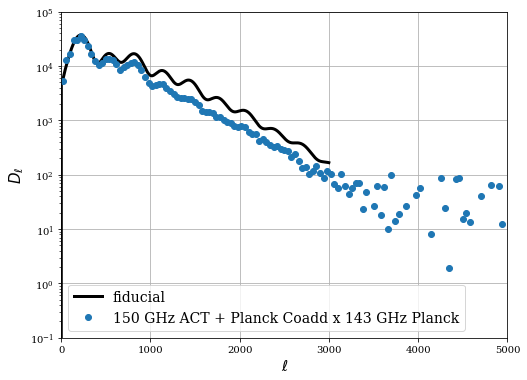

In [30]:
# Read in a camb fiducial spectrum for comparison
from pixell import powspec
camb_theory = powspec.read_spectrum(path + "camb_theory.dat")
cltt = camb_theory[0,0,:3000]
ls = np.arange(cltt.size)

# Now plot the quick powerspectrum we just made
plt.figure(figsize = (8,6))
plt.rc('font', family='serif')

plt.plot(ls,cltt*ls**2.,lw=3,color='k', label = "fiducial")
plt.plot(ell_b,ell_b**2*binned_power,marker="o",ls="none", label = "150 GHz ACT + Planck Coadd x 143 GHz Planck")
plt.yscale('log')
plt.xlabel('$\\ell$', fontsize = 15)
plt.ylabel('$D_{\\ell}$', fontsize = 15)
plt.xlim(0, 5000)
plt.ylim(.1, 1e5)
plt.grid(True)
plt.legend(fontsize = 14)
plt.show()

## Spherical harmonics using Pixell

For this we turn to Pixell's curvedsky functions that enable spherical harmonic analysis of the patches.  The process is very similar what one would do using the HEALPix library.  We will get alms from the maps and then from there we get the cls from the alms. 

Again we want to weight our power spectrum by an area correction factor as well as the taper we've applied

In [31]:
from pixell import curvedsky 

# First we get the alms
alms_act = np.cdouble(curvedsky.map2alm(smap_act*taper, lmax = 6000))
alms_planck = np.cdouble(curvedsky.map2alm(smap_planck*taper*1e6, lmax = 6000)[0])

# Next step we get the cls using healpy
cls = hp.alm2cl(alms_act, alms_planck)

# We also want the corresponding ells which we can get easily
ell = np.arange(len(cls))

# Now we calculate the weighting we have to apply to our spectrum due to the 
# trimmed size
w2_new = enmap.area(smap_act.shape, smap_act.wcs)/4./np.pi

# Now we combine these to get the Dls
Dl = cls*ell**2 /w2_new 

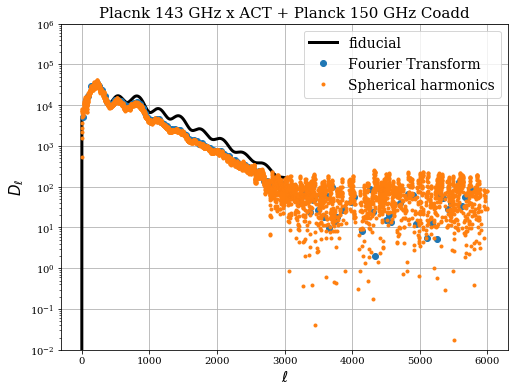

In [32]:
 # Now we can plot our power spectrum
plt.figure(figsize = (8,6))
plt.rc('font', family='serif')
plt.grid(True)
plt.plot(ls,cltt*ls**2.,lw=3,color='k', label = "fiducial")
plt.plot(ell_b,ell_b**2*binned_power,marker="o",ls="none", label = "Fourier Transform")
plt.plot(ell, Dl, '.', label = "Spherical harmonics")
plt.yscale('log')
plt.xlabel('$\\ell$', fontsize = 15)
plt.ylabel('$D_{\\ell}$', fontsize = 15)
plt.title("Placnk 143 GHz x ACT + Planck 150 GHz Coadd", fontsize = 15)
plt.ylim(.01 ,1e6)
plt.legend(fontsize = 14)
plt.show()

In the plot above we can quite clearly see some of the acoustic oscillations as we would expect. However, there are a few glaring problems with this spectrum.  Firstly we didn't mask point sources which can be done using the correct Planck mask and the source free ACT maps.  The spectrum also hasn't been corrected for beams or other pixel transfer functions both of which would need to be done for a true analysis.  These effects are easily noticeable at high ell where our power spectra underestimates the fiducial spectra.

Further more we account for the window function using a relatively simple approach, however, to truly decouple it one should use a program such as **Namaster**, **pspy** or **pitas** which explicitly decouple the window functions.

Finally it's important to realize that calculating the error for any cross correlations would need to include knowledge of the noise model which is currently not complete.  

Despite the limitations quick power spectra can be made relatively easily using this approach and can be done with galaxy density maps or other CMB maps.

# Section 8: Generating E and B maps

While the data release includes I, Q and U maps we do not specifically release the E and B maps presented in DR4.  Here we will show how to recover them using the I, Q and U maps.

We start by reading in the source and source free maps needed for this process and then trimming them down to a smaller size.  From there we will use enmap's functions to convert the maps to harmonics and then inverse Fourier transform the harmonic maps to get the E and B maps.

In [33]:
# To begin with we need to add in the Q and U maps for the same coadded patch
# We then trim them, using submap, to the size of the small patch from earlier
imap = enmap.read_map(path + "act_planck_s08_s18_cmb_f150_night_map_Q.fits")
smap_Q = imap.submap(box)

imap = enmap.read_map(path + "act_planck_s08_s18_cmb_f150_night_map_U.fits")
smap_U = imap.submap(box)

# Once we have them we will combine them into one object
smap_TQU = enmap.zeros((3,)+smap_act.shape, smap_act.wcs)
smap_TQU[0:3] = smap_act, smap_Q, smap_U

Since this process involves taking Fourier transformations of the maps we want to apply a mask that tapers the edges of the maps.  We can do so using the enmap.apod function which will force the maps to taper off to zero at the edges.

In [ ]:
# Define taper using enmap.apod and then plot the taper
apod_pix = 40 
taper = enmap.apod(smap_TQU*0+1,apod_pix) 
eshow(taper[0],  **{"downgrade": 2, "colorbar":True, "ticks": 2})

# Apply taper to the smap by multiplying the two maps together
smap_TQU *= taper

In [ ]:
# Here are the inital TQU maps with the tapers applied
eshow(smap_TQU, **{"downgrade": 2, "colorbar":True, "ticks": 1})
smap_TQU[1].wcs
smap_TQU.shape

The next step is to convert these to E and B and maps.  Enmap allows us to do so using the map2harm function.  We set the normalization to 'phys' for physical which normalizes the maps such that the binned square of the Fourier transformation can be directly compared to theory (apart from mask corrections).  

From there we combine all five maps (TQUEB) in a single map object them and plot them.

In [36]:
# Apply Transformation to get T,E,B harmonic maps from the T,Q,U real-space maps
f_smap = enmap.map2harm(smap_TQU, normalize = "phys")

# Create a map object to hold all five maps
maps_TQUEB = enmap.zeros((5,)+smap_act.shape, smap_act.wcs)

# We now fill in the object.  The first three remain the same as the originals
# The second two are the EB maps which we get by inverse fourier transforming the 
# Harmonic maps in f_smap

maps_TQUEB[0:3] = smap_TQU
maps_TQUEB[3:]  = enmap.ifft(f_smap, normalize = "phys").real[1:]

In [ ]:
# Now we plot all five maps in order T, Q, U, E and the B

eshow(maps_TQUEB[0], **{"downgrade": 2, "ticks": 1, "color" : "planck", "range": 250})
eshow(maps_TQUEB[1:], **{"downgrade": 2, "ticks": 1, "color" : "gray", "range": 25})